In [1]:
import cv2 as cv
import numpy as np
import os
import pandas as pd
import re
import matplotlib.pyplot as plt

def parse_corners_with_regex(corners_str):
    # Find all numbers in the string
    numbers = re.findall(r'\d+', corners_str)
    # Convert to integers
    numbers = [int(num) for num in numbers]
    # Reshape into 4x2 array (assuming there are 8 numbers)
    corners_array = np.array(numbers).reshape(-1, 2)
    return corners_array

general_folder_path = '/home/oussama/Documents/EPFL/PDS_LUTS/'

# Load the full panorama
panorama_path = os.path.join(general_folder_path, 'aligned_image.jpg')
panorama = cv.imread(panorama_path)

# Load the DataFrame
image_corners_df = pd.read_csv(os.path.join(general_folder_path, 'results/image_corners.csv'))

# Ensure 'frame_number' is of integer type (it already is, but this is explicit)
image_corners_df['frame_number'] = image_corners_df['frame_number'].astype(int)

# Parse the 'corners' column
image_corners_df['corners'] = image_corners_df['corners'].apply(parse_corners_with_regex)

# Adjust 'frames_to_crop' to match the integer 'frame_number' values
frames_to_crop = [200, 400]  # Use integers

# Filter the DataFrame
cropped_frames_df = image_corners_df[image_corners_df['frame_number'].isin(frames_to_crop)]

# Proceed with the rest of your code
# Extract the corners and compute the bounding box
all_corners = np.vstack(cropped_frames_df['corners'].values)
x_min_pano, y_min_pano = np.min(all_corners, axis=0).astype(int)
x_max_pano, y_max_pano = np.max(all_corners, axis=0).astype(int)

# Crop the panorama
cropped_panorama = panorama[y_min_pano:y_max_pano, x_min_pano:x_max_pano]

# Optionally, save or display the cropped panorama
cv.imwrite(os.path.join(general_folder_path, 'cropped_panorama.jpg'), cropped_panorama)


True

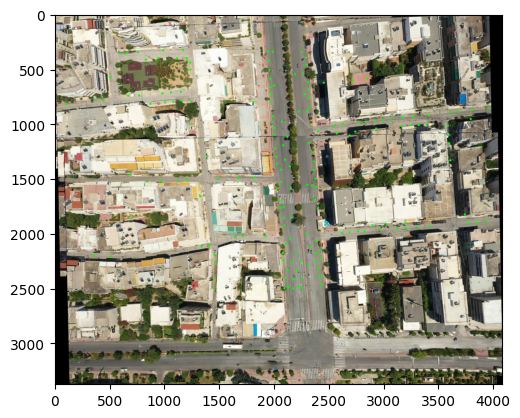

In [2]:
import os
import cv2 as cv
import numpy as np
import torch
from PIL import Image
import torchvision.transforms.functional as TF
from lightglue import LightGlue, DoGHardNet
from lightglue.utils import match_pair

# Define the general folder path
general_folder_path = '/home/oussama/Documents/EPFL/PDS_LUTS/'

panorama = cv.imread(os.path.join(general_folder_path, 'cropped_panorama.jpg'))

# Initialize feature extractor and matcher
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
extractor = DoGHardNet(max_num_keypoints=None).eval().to(device)
matcher = LightGlue(features='doghardnet').eval().to(device)

# Load frame 0250 using cv.imread (BGR format)
frame_number_to_match = '0360'
frame_path = os.path.join(general_folder_path, f'images_updated_3840x2160/{frame_number_to_match}.jpg')
frame_image_cv = cv.imread(frame_path)  # BGR format

# Convert frame image to RGB and then to tensor for feature matching
frame_image_rgb = cv.cvtColor(frame_image_cv, cv.COLOR_BGR2RGB)
frame_image_pil = Image.fromarray(frame_image_rgb)
frame_image_tensor = TF.to_tensor(frame_image_pil).unsqueeze(0).to(device)

# Load the cropped panorama using cv.imread (BGR format)
cropped_panorama_path = os.path.join(general_folder_path, 'cropped_panorama.jpg')
cropped_panorama = cv.imread(cropped_panorama_path)  # BGR format

# Convert cropped panorama to RGB and then to tensor for feature matching
cropped_panorama_rgb = cv.cvtColor(cropped_panorama, cv.COLOR_BGR2RGB)
cropped_panorama_pil = Image.fromarray(cropped_panorama_rgb)
cropped_panorama_tensor = TF.to_tensor(cropped_panorama_pil).unsqueeze(0).to(device)

# Perform feature matching
feats0, feats1, matches01 = match_pair(extractor, matcher, frame_image_tensor, cropped_panorama_tensor)

# Extract matched keypoints
points0 = feats0['keypoints'][matches01['matches'][..., 0]].cpu().numpy()  # Keypoints from frame 0250
points1 = feats1['keypoints'][matches01['matches'][..., 1]].cpu().numpy()  # Keypoints from cropped panorama

if points0.shape[0] >= 4:
    # Compute homography from frame to panorama
    M, _ = cv.findHomography(points0, points1, cv.RANSAC, 5.0)
    if M is not None:
        # --- Read tracking data from file and transform the points ---

        # Path to the tracking data file
        bbox_file_path = os.path.join(general_folder_path, f'Dataset/DJI_0763_tracking/track_fr_{frame_number_to_match}.txt')

        # Check if the file exists
        if not os.path.isfile(bbox_file_path):
            print(f"Tracking data file not found: {bbox_file_path}")
            exit()

        # Parse the tracking data from the file
        tracking_points = []
        with open(bbox_file_path, 'r') as f:
            for line in f:
                parts = line.strip().split(',')
                if len(parts) >= 4:
                    track_id = int(parts[0])
                    x_center = float(parts[1])
                    y_center = float(parts[2])
                    confidence = float(parts[3]) if len(parts) > 3 else None
                    tracking_points.append({
                        'id': track_id,
                        'center': [x_center, y_center],
                        'confidence': confidence
                    })

        # Make a copy of the cropped panorama to draw on
        panorama_with_points = cropped_panorama.copy()

        # Define colors and font for drawing
        point_color = (0, 255, 0)  # Green color for points
        text_color = (0, 0, 255)   # Red color for text
        font = cv.FONT_HERSHEY_SIMPLEX
        font_scale = 0.5
        thickness = 2

        # Set your desired confidence threshold
        confidence_threshold = 0.5  # Adjust this value as needed

        # Loop through each tracking point
        for point_data in tracking_points:
            track_id = point_data['id']
            center = point_data['center']
            confidence = point_data['confidence']

            # Treat None confidence as less than any threshold
            if confidence < confidence_threshold:
                continue  # Skip this point

            # Convert center to numpy array
            center_point = np.array([center], dtype=np.float32)  # Shape (1, 2)

            # Transform the center point using the homography matrix
            transformed_center = cv.perspectiveTransform(center_point[None, :, :], M)[0][0]

            # # Adjust for the cropping offset
            # transformed_center[0] -= x_min_pano
            # transformed_center[1] -= y_min_pano

            # Convert to integer coordinates for drawing
            transformed_center_int = transformed_center.astype(int)

            # Draw the point on the panorama
            cv.circle(panorama_with_points, tuple(transformed_center_int), radius=10, color=point_color, thickness=-1)

        # Save and display the panorama with points
        output_image_path = os.path.join(general_folder_path, 'panorama_with_points.jpg')
        cv.imwrite(output_image_path, panorama_with_points)

        # Optionally display the image
        plt.imshow(cv.cvtColor(panorama_with_points, cv.COLOR_BGR2RGB))
    else:
        print("Homography computation failed.")
else:
    print("Not enough matches to compute homography.")


In [8]:
import os
import cv2 as cv
import numpy as np
import torch
from PIL import Image
import torchvision.transforms.functional as TF
from lightglue import LightGlue, DoGHardNet
from lightglue.utils import match_pair
import matplotlib.pyplot as plt
from ipywidgets import interact, IntSlider
import warnings
warnings.filterwarnings('ignore')

# Define the general folder path
general_folder_path = '/home/oussama/Documents/EPFL/PDS_LUTS/'

# Load the cropped panorama
cropped_panorama_path = os.path.join(general_folder_path, 'cropped_panorama.jpg')
cropped_panorama = cv.imread(cropped_panorama_path)  # BGR format

# Ensure the panorama was loaded
if cropped_panorama is None:
    print("Failed to load the cropped panorama.")
    raise SystemExit

# # Load x_min_pano and y_min_pano from previous computation
# # Replace these with your actual computed values from the first cell
# x_min_pano = ...  # Replace with actual x_min_pano value
# y_min_pano = ...  # Replace with actual y_min_pano value

# Initialize feature extractor and matcher
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
extractor = DoGHardNet(max_num_keypoints=None).eval().to(device)
matcher = LightGlue(features='doghardnet').eval().to(device)

# Load the images from the images folder to get the frame numbers
images_folder = os.path.join(general_folder_path, 'images_updated_3840x2160')
image_files = sorted([f for f in os.listdir(images_folder) if f.endswith('.jpg')])
frame_numbers = [int(os.path.splitext(f)[0]) for f in image_files]
min_frame_number = min(frame_numbers)
max_frame_number = max(frame_numbers)

def process_frame(frame_number):
    # Ensure frame_number is zero-padded to match filenames
    frame_number_str = f'{frame_number:04d}'  # Adjust padding as needed

    # Load frame image
    frame_path = os.path.join(images_folder, f'{frame_number_str}.jpg')
    if not os.path.isfile(frame_path):
        print(f"Frame image not found: {frame_path}")
        return

    frame_image_cv = cv.imread(frame_path)  # BGR format
    if frame_image_cv is None:
        print(f"Failed to load frame image: {frame_path}")
        return

    # Convert frame image to RGB and then to tensor for feature matching
    frame_image_rgb = cv.cvtColor(frame_image_cv, cv.COLOR_BGR2RGB)
    frame_image_pil = Image.fromarray(frame_image_rgb)
    frame_image_tensor = TF.to_tensor(frame_image_pil).unsqueeze(0).to(device)

    # Convert cropped panorama to RGB and then to tensor for feature matching
    cropped_panorama_rgb = cv.cvtColor(cropped_panorama, cv.COLOR_BGR2RGB)
    cropped_panorama_pil = Image.fromarray(cropped_panorama_rgb)
    cropped_panorama_tensor = TF.to_tensor(cropped_panorama_pil).unsqueeze(0).to(device)

    # Perform feature matching
    feats0, feats1, matches01 = match_pair(extractor, matcher, frame_image_tensor, cropped_panorama_tensor)

    # Extract matched keypoints
    points0 = feats0['keypoints'][matches01['matches'][..., 0]].cpu().numpy()  # Keypoints from frame
    points1 = feats1['keypoints'][matches01['matches'][..., 1]].cpu().numpy()  # Keypoints from cropped panorama

    if points0.shape[0] >= 4:
        # Compute homography from frame to panorama
        M, _ = cv.findHomography(points0, points1, cv.RANSAC, 5.0)
        if M is not None:
            # --- Read tracking data from file and transform the points ---
            # Path to the tracking data file
            bbox_file_path = os.path.join(general_folder_path, f'Dataset/DJI_0763_tracking/track_fr_{frame_number_str}.txt')

            # Check if the file exists
            if not os.path.isfile(bbox_file_path):
                print(f"Tracking data file not found: {bbox_file_path}")
                return

            # Parse the tracking data from the file
            tracking_points = []
            with open(bbox_file_path, 'r') as f:
                for line in f:
                    parts = line.strip().split(',')
                    if len(parts) >= 4:
                        track_id = int(parts[0])
                        x_center = float(parts[1])
                        y_center = float(parts[2])
                        confidence = float(parts[3]) if len(parts) > 3 else None
                        tracking_points.append({
                            'id': track_id,
                            'center': [x_center, y_center],
                            'confidence': confidence
                        })

            # Make a copy of the cropped panorama to draw on
            panorama_with_points = cropped_panorama.copy()

            # Define colors and font for drawing
            point_color = (0, 255, 0)  # Green color for points

            # Set your desired confidence threshold
            confidence_threshold = 0.5  # Adjust this value as needed

            # Loop through each tracking point
            for point_data in tracking_points:
                track_id = point_data['id']
                center = point_data['center']
                confidence = point_data['confidence']

                # Treat None confidence as less than any threshold
                if confidence < confidence_threshold:
                    continue  # Skip this point

                # Convert center to numpy array
                center_point = np.array([center], dtype=np.float32)  # Shape (1, 2)

                # Transform the center point using the homography matrix
                transformed_center = cv.perspectiveTransform(center_point[None, :, :], M)[0][0]

                # Convert to integer coordinates for drawing
                transformed_center_int = transformed_center.astype(int)

                # Draw the point on the panorama
                cv.circle(panorama_with_points, tuple(transformed_center_int), radius=17, color=point_color, thickness=-1)

            # Display the panorama with points
            plt.figure(figsize=(12, 8))
            plt.imshow(cv.cvtColor(panorama_with_points, cv.COLOR_BGR2RGB))
            plt.title(f'Frame {frame_number_str}')
            plt.axis('off')
            plt.show()

        else:
            print("Homography computation failed.")
    else:
        print("Not enough matches to compute homography.")

# Create the interactive slider
interact(process_frame, frame_number=IntSlider(min=min_frame_number, max=max_frame_number, step=10, value=min_frame_number))

interactive(children=(IntSlider(value=200, description='frame_number', max=390, min=200, step=10), Output()), …

<function __main__.process_frame(frame_number)>

Processing frame 0200
Frame image not found: /home/oussama/Documents/EPFL/PDS_LUTS/images_updated_3840x2160/0200.jpg
Processing frame 0210
Frame image not found: /home/oussama/Documents/EPFL/PDS_LUTS/images_updated_3840x2160/0210.jpg
Processing frame 0220
Frame image not found: /home/oussama/Documents/EPFL/PDS_LUTS/images_updated_3840x2160/0220.jpg
Processing frame 0230
Frame image not found: /home/oussama/Documents/EPFL/PDS_LUTS/images_updated_3840x2160/0230.jpg
Processing frame 0240
Frame image not found: /home/oussama/Documents/EPFL/PDS_LUTS/images_updated_3840x2160/0240.jpg
Processing frame 0250
Frame image not found: /home/oussama/Documents/EPFL/PDS_LUTS/images_updated_3840x2160/0250.jpg
Processing frame 0260
Frame image not found: /home/oussama/Documents/EPFL/PDS_LUTS/images_updated_3840x2160/0260.jpg
Processing frame 0270
Frame image not found: /home/oussama/Documents/EPFL/PDS_LUTS/images_updated_3840x2160/0270.jpg
Processing frame 0280
Frame image not found: /home/oussama/Docum

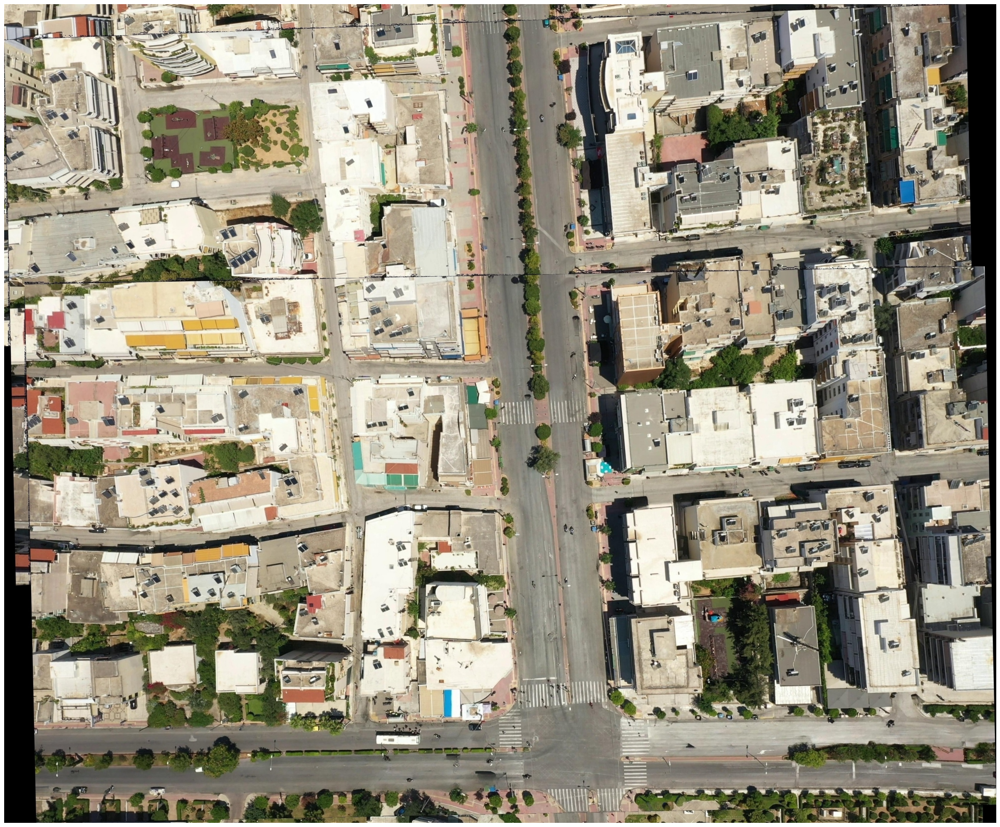

In [1]:
import os
import cv2 as cv
import numpy as np
import torch
from PIL import Image
import torchvision.transforms.functional as TF
from lightglue import LightGlue, DoGHardNet
from lightglue.utils import match_pair
import matplotlib.pyplot as plt
from collections import defaultdict
import random
import warnings
warnings.filterwarnings('ignore')

# Define the general folder path
general_folder_path = '/home/oussama/Documents/EPFL/PDS_LUTS/'

# Load the cropped panorama
cropped_panorama_path = os.path.join(general_folder_path, 'cropped_panorama.jpg')
cropped_panorama = cv.imread(cropped_panorama_path)  # BGR format

# Ensure the panorama was loaded
if cropped_panorama is None:
    print("Failed to load the cropped panorama.")
    raise SystemExit

# Initialize feature extractor and matcher
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
extractor = DoGHardNet(max_num_keypoints=None).eval().to(device)
matcher = LightGlue(features='doghardnet').eval().to(device)

# Load the images from the images folder to get the frame numbers
images_folder = os.path.join(general_folder_path, 'images_updated_3840x2160')
image_files = sorted([f for f in os.listdir(images_folder) if f.endswith('.jpg')])
frame_numbers = [int(os.path.splitext(f)[0]) for f in image_files]
min_frame_number = min(frame_numbers)
max_frame_number = max(frame_numbers)

# Define the range of frames to process
# For example, process frames from 200 to 400
start_frame = 200
end_frame = 400
step_frame = 10  # Process every 10th frame to reduce computation time

# Dictionary to store trajectories for each vehicle ID
trajectories = defaultdict(list)

# Convert cropped panorama to RGB once (for visualization)
cropped_panorama_rgb = cv.cvtColor(cropped_panorama, cv.COLOR_BGR2RGB)

# Loop over the frames
for frame_number in range(start_frame, end_frame, step_frame):
    # Ensure frame_number is zero-padded to match filenames
    frame_number_str = f'{frame_number:04d}'  # Adjust padding as needed

    print(f'Processing frame {frame_number_str}')

    # Load frame image
    frame_path = os.path.join(images_folder, f'{frame_number_str}.jpg')
    if not os.path.isfile(frame_path):
        print(f"Frame image not found: {frame_path}")
        continue

    frame_image_cv = cv.imread(frame_path)  # BGR format
    if frame_image_cv is None:
        print(f"Failed to load frame image: {frame_path}")
        continue

    # Convert frame image to RGB and then to tensor for feature matching
    frame_image_rgb = cv.cvtColor(frame_image_cv, cv.COLOR_BGR2RGB)
    frame_image_pil = Image.fromarray(frame_image_rgb)
    frame_image_tensor = TF.to_tensor(frame_image_pil).unsqueeze(0).to(device)

    # Convert cropped panorama to tensor for feature matching
    cropped_panorama_pil = Image.fromarray(cropped_panorama_rgb)
    cropped_panorama_tensor = TF.to_tensor(cropped_panorama_pil).unsqueeze(0).to(device)

    # Perform feature matching
    feats0, feats1, matches01 = match_pair(extractor, matcher, frame_image_tensor, cropped_panorama_tensor)

    # Extract matched keypoints
    points0 = feats0['keypoints'][matches01['matches'][..., 0]].cpu().numpy()  # Keypoints from frame
    points1 = feats1['keypoints'][matches01['matches'][..., 1]].cpu().numpy()  # Keypoints from cropped panorama

    if points0.shape[0] >= 4:
        # Compute homography from frame to panorama
        M, _ = cv.findHomography(points0, points1, cv.RANSAC, 5.0)
        if M is not None:
            # --- Read tracking data from file and transform the points ---
            # Path to the tracking data file
            bbox_file_path = os.path.join(general_folder_path, f'Dataset/DJI_0763_tracking/track_fr_{frame_number_str}.txt')

            # Check if the file exists
            if not os.path.isfile(bbox_file_path):
                print(f"Tracking data file not found: {bbox_file_path}")
                continue

            # Parse the tracking data from the file
            tracking_points = []
            with open(bbox_file_path, 'r') as f:
                for line in f:
                    parts = line.strip().split(',')
                    if len(parts) >= 4:
                        track_id = int(parts[0])
                        x_center = float(parts[1])
                        y_center = float(parts[2])
                        confidence = float(parts[3]) if len(parts) > 3 else None
                        tracking_points.append({
                            'id': track_id,
                            'center': [x_center, y_center],
                            'confidence': confidence
                        })

            # Set your desired confidence threshold
            confidence_threshold = 0.5  # Adjust this value as needed

            # Loop through each tracking point
            for point_data in tracking_points:
                track_id = point_data['id']
                center = point_data['center']
                confidence = point_data['confidence']

                # Treat None confidence as less than any threshold
                if confidence is None or confidence < confidence_threshold:
                    continue  # Skip this point

                # Convert center to numpy array
                center_point = np.array([center], dtype=np.float32)  # Shape (1, 2)

                # Transform the center point using the homography matrix
                transformed_center = cv.perspectiveTransform(center_point[None, :, :], M)[0][0]

                # Append the transformed point to the trajectory of the vehicle
                trajectories[track_id].append(transformed_center)
        else:
            print("Homography computation failed.")
    else:
        print("Not enough matches to compute homography.")

# After processing all frames, plot the trajectories
# Create a figure to display the panorama
plt.figure(figsize=(40, 20))
plt.imshow(cropped_panorama_rgb)
plt.axis('off')

# Generate unique colors for each vehicle ID
vehicle_ids = list(trajectories.keys())
num_vehicles = len(vehicle_ids)
random.seed(42)  # For reproducibility
colors = {}
for vehicle_id in vehicle_ids:
    colors[vehicle_id] = [random.randint(0, 255) for _ in range(3)]

# Plot the trajectories
for vehicle_id, points in trajectories.items():
    points = np.array(points)
    # Ensure points are within the image bounds
    height, width, _ = cropped_panorama_rgb.shape
    valid_indices = (points[:, 0] >= 0) & (points[:, 0] < width) & (points[:, 1] >= 0) & (points[:, 1] < height)
    points = points[valid_indices]
    if points.shape[0] >= 2:
        plt.plot(points[:, 0], points[:, 1], '-', color=np.array(colors[vehicle_id])/255.0, linewidth=4, label=f'ID {vehicle_id}')
        # Optionally, mark the start and end points
        plt.plot(points[0, 0], points[0, 1], 'o', color=np.array(colors[vehicle_id])/255.0, markersize=5)
        plt.plot(points[-1, 0], points[-1, 1], 's', color=np.array(colors[vehicle_id])/255.0, markersize=5)
    elif points.shape[0] == 1:
        plt.plot(points[0, 0], points[0, 1], 'o', color=np.array(colors[vehicle_id])/255.0, markersize=5, label=f'ID {vehicle_id}')


# Save and display the final image
output_image_path = os.path.join(general_folder_path, 'panorama_with_trajectories.jpg')
plt.tight_layout()
plt.savefig(output_image_path, bbox_inches='tight')
plt.show()


In [1]:
import os
import cv2
import shutil
from tqdm import tqdm
from PIL import Image, ImageDraw
import torch
import os
from PIL import Image, ImageDraw
from simple_lama_inpainting import SimpleLama
from tqdm import tqdm
import re


def select_and_inpaint_frames(
    video_path, temp_folder, txt_folder, output_folder,
    start_frame, step_frame, end_frame, dimensions=(3840, 2160), offset=10
):
    """
    Selects frames from a video, processes them with inpainting based on bounding boxes, 
    and saves the results to an output folder.

    Parameters
    ----------
    video_path : str
        Path to the input video file.

    temp_folder : str
        Path to the temporary folder where the frames will be temporarily saved.

    txt_folder : str
        Path to the folder containing bounding box text files.

    output_folder : str
        Path to the folder where the inpainted results will be saved.

    start_frame : int
        The starting frame index to begin processing.

    step_frame : int
        The step size to select frames (e.g., every 10th frame).

    end_frame : int
        The ending frame index (non-inclusive) for processing.

    dimensions : tuple
        Target dimensions for resizing the frames (width, height).

    offset : int
        Offset to expand the bounding box region for masking.

    Returns
    -------
    None
    """
    # Ensure the necessary folders exist
    os.makedirs(temp_folder, exist_ok=True)
    os.makedirs(output_folder, exist_ok=True)

    # Clean the temporary folder
    for file in os.listdir(temp_folder):
        file_path = os.path.join(temp_folder, file)
        try:
            os.remove(file_path)
        except Exception as e:
            print(f"Error removing file {file_path}: {e}")

    # Clean the temporary folder
    for file in os.listdir(output_folder):
        file_path = os.path.join(output_folder, file)
        try:
            os.remove(file_path)
        except Exception as e:
            print(f"Error removing file {file_path}: {e}")

    # Adjust start_frame to the nearest multiple of step_frame
    adjusted_start_frame = start_frame + (step_frame - (start_frame % step_frame)) % step_frame

    # Open the video file
    cap = cv2.VideoCapture(video_path)
    if not cap.isOpened():
        print(f"Error: Cannot open video {video_path}")
        return

    frame_index = 0  # Counter to track the current frame in the video
    selected_frame_index = adjusted_start_frame  # Frame to start processing


    # Progress bar setup
    total_frames = (end_frame - adjusted_start_frame) // step_frame + 1
    progress_bar = tqdm(total=total_frames, desc="Processing frames")

    while cap.isOpened():
        ret, frame = cap.read()
        if not ret:
            break  # End of video

        # Process the frame if it matches the selected frame index
        if frame_index == selected_frame_index:
            # Save the frame temporarily
            frame_filename = f"{selected_frame_index:04d}.jpg"
            frame_filepath = os.path.join(temp_folder, frame_filename)
            cv2.imwrite(frame_filepath, frame)

            # Perform inpainting
            image = Image.open(frame_filepath).convert("RGB")
            image = image.resize(dimensions)
            mask = Image.new("L", dimensions, 0)

            # Load the corresponding txt file
            txt_filename = f"det_fr_{selected_frame_index:04d}.txt"
            txt_filepath = os.path.join(txt_folder, txt_filename)
            if os.path.isfile(txt_filepath):
                draw = ImageDraw.Draw(mask)
                with open(txt_filepath, "r") as f:
                    lines = f.readlines()
                    for line in lines:
                        values = list(map(int, line.strip().split(',')[:8]))

                        # Scale and offset bounding box coordinates
                        scaling_factor_x = dimensions[0] / frame.shape[1]
                        scaling_factor_y = dimensions[1] / frame.shape[0]

                        x1, y1 = int(values[0] * scaling_factor_x), int(values[1] * scaling_factor_y)
                        x2, y2 = int(values[2] * scaling_factor_x), int(values[3] * scaling_factor_y)
                        x3, y3 = int(values[4] * scaling_factor_x), int(values[5] * scaling_factor_y)
                        x4, y4 = int(values[6] * scaling_factor_x), int(values[7] * scaling_factor_y)

                        x_min = min(x1, x2, x3, x4) - offset
                        y_min = min(y1, y2, y3, y4) - offset
                        x_max = max(x1, x2, x3, x4) + offset
                        y_max = max(y1, y2, y3, y4) + offset

                        draw.rectangle([x_min, y_min, x_max, y_max], fill=255)

            # Inpainting
            # result = simple_lama(image, mask)

            # Save the inpainted result
            output_filepath = os.path.join(output_folder, frame_filename)
            image.save(output_filepath)

            # Increment to the next selected frame
            selected_frame_index += step_frame
            progress_bar.update(1)

        # Stop if we exceed the end_frame
        if frame_index >= end_frame:
            break

        frame_index += 1  # Move to the next frame

    # Release the video capture and close the progress bar
    cap.release()
    progress_bar.close()

    # Clean the temporary folder after use
    for file in os.listdir(temp_folder):
        file_path = os.path.join(temp_folder, file)
        try:
            os.remove(file_path)
        except Exception as e:
            print(f"Error removing file {file_path}: {e}")

# Example usage
video_path = '/home/oussama/Documents/EPFL/PDS_LUTS/Dataset/DJI_0763.MOV'
temp_folder = '/home/oussama/Documents/EPFL/PDS_LUTS/temp_frames'
txt_folder = '/home/oussama/Documents/EPFL/PDS_LUTS/Dataset/DJI_0763_detection'
output_folder = '/home/oussama/Documents/EPFL/PDS_LUTS/inpainted_frames'

start_frame = 3743
step_frame = 10
end_frame = 3931

# # Initialize SimpleLama
# device = 'cuda' if torch.cuda.is_available() else 'cpu'
# simple_lama = SimpleLama(device=device)

# select_and_inpaint_frames(
#     video_path=video_path,
#     temp_folder=temp_folder,
#     txt_folder=txt_folder,
#     output_folder=output_folder,
#     start_frame=start_frame,
#     step_frame=step_frame,
#     end_frame=end_frame
# )


Processing frames: 100%|██████████| 19/19 [00:38<00:00,  2.03s/it]


In [2]:
import os
import cv2 as cv
import numpy as np
import torch
from PIL import Image
import torchvision.transforms.functional as TF
from lightglue import LightGlue, DoGHardNet
from lightglue.utils import match_pair
from collections import defaultdict
import ast  # For parsing corners from DataFrame strings
import pandas as pd
import warnings
warnings.filterwarnings('ignore')


def fix_corners_format(corners_str):
    """Fix corners format to convert from string to a NumPy array."""
    corners_str = corners_str.replace('\n', '').replace('  ', ' ').replace('[ ', '[')
    corners_str = corners_str.replace(' [', ',[').replace('  ', ',').replace(' ', ',')
    try:
        corners = ast.literal_eval(corners_str)
        return np.array(corners)
    except Exception as e:
        print(f"Error parsing corners: {corners_str}\n{e}")
        return np.array([])


def crop_map(map_image, corners):
    """
    Crops the region from the map based on the given corners.

    Parameters
    ----------
    map_image : np.ndarray
        The full map image as a NumPy array in BGR or RGB format.

    corners : np.ndarray
        A (4, 2) array specifying the rectangular region to crop. Example:
        [[x_min, y_min], [x_max, y_min], [x_max, y_max], [x_min, y_max]]

    Returns
    -------
    np.ndarray
        The cropped portion of the map.
    """
    x_min = int(np.min(corners[:, 0]))
    x_max = int(np.max(corners[:, 0]))
    y_min = int(np.min(corners[:, 1]))
    y_max = int(np.max(corners[:, 1]))

    # Ensure the coordinates are within the bounds of the image
    x_min = max(0, x_min)
    y_min = max(0, y_min)
    x_max = min(map_image.shape[1], x_max)
    y_max = min(map_image.shape[0], y_max)

    return map_image[y_min:y_max, x_min:x_max]

def rotate_image_and_tracking_data(image, tracking_file, angle):
    """
    Rotates the image and applies the same rotation to the tracking data.

    Parameters
    ----------
    image : np.ndarray
        The input image (as a NumPy array).

    tracking_file : str
        Path to the tracking file containing lines with format: id, x_center, y_center, confidence.

    angle : float
        The angle to rotate the image (in degrees).

    Returns
    -------
    rotated_image : np.ndarray
        The rotated image.

    rotated_tracking_points : list
        A list of transformed tracking points with format: [track_id, x_center_rotated, y_center_rotated].
    """
    # Get image dimensions
    height, width = image.shape[:2]

    # Compute the center of the image
    center = (width // 2, height // 2)

    # Create the rotation matrix
    rotation_matrix = cv2.getRotationMatrix2D(center, angle, 1.0)

    # Perform the image rotation
    rotated_image = cv2.warpAffine(image, rotation_matrix, (width, height))

    # Read and transform tracking data
    rotated_tracking_points = []
    with open(tracking_file, 'r') as f:
        for line in f:
            parts = line.strip().split(',')
            if len(parts) < 4:
                continue

            track_id = int(parts[0])
            x_center = float(parts[1])
            y_center = float(parts[2])

            # Transform the (x, y) coordinates using the rotation matrix
            original_point = np.array([[x_center, y_center, 1.0]])  # Homogeneous coordinates
            rotated_point = original_point @ rotation_matrix.T  # Apply transformation

            x_center_rotated, y_center_rotated = rotated_point[0][:2]  # Extract rotated x, y

            # Save transformed tracking point
            rotated_tracking_points.append([track_id, x_center_rotated, y_center_rotated])

    return rotated_image, rotated_tracking_points

def track_vehicles_in_between_frames(
    map_image,
    df,
    images_folder,
    bounding_data_folder,
    start_frame,
    end_frame,
    step_frame=10,
    trajectories=None,
    confidence_threshold=0.5,
    device=None
):
    """
    Tracks vehicles between two frames and stores their global trajectories.

    Adjusts start frame to the nearest multiple of `step_frame` greater than or equal to `start_frame`.

    Parameters
    ----------
    [same as before]

    Returns
    -------
    dict
        A dictionary of trajectories keyed by vehicle ID.
    """
    # 1. Initialize 'trajectories' if not provided
    if trajectories is None:
        trajectories = defaultdict(list)

    # 2. Determine device
    if device is None:
        device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

    # 3. Extract corners for start_frame and end_frame from DataFrame
    df_start = df.loc[df['frame_number'] == start_frame]
    df_end = df.loc[df['frame_number'] == end_frame]

    if df_start.empty or df_end.empty:
        print(f"Frame data not found for frames {start_frame} or {end_frame}.")
        return trajectories

    corners_start = fix_corners_format(df_start.iloc[0]['corners'])
    corners_end = fix_corners_format(df_end.iloc[0]['corners'])

    # 4. Compute bounding box for the cropped region
    x_min = min(np.min(corners_start[:, 0]), np.min(corners_end[:, 0]))
    x_max = max(np.max(corners_start[:, 0]), np.max(corners_end[:, 0]))
    y_min = min(np.min(corners_start[:, 1]), np.min(corners_end[:, 1]))
    y_max = max(np.max(corners_start[:, 1]), np.max(corners_end[:, 1]))

    offset_corners = np.array([[x_min, y_min], [x_max, y_min], [x_max, y_max], [x_min, y_max]])
    cropped_map = crop_map(map_image, offset_corners)

    # 5. Convert cropped_map to RGB and then to a tensor
    cropped_map_rgb = cv.cvtColor(cropped_map, cv.COLOR_BGR2RGB)
    cropped_map_pil = Image.fromarray(cropped_map_rgb)
    cropped_map_tensor = TF.to_tensor(cropped_map_pil).unsqueeze(0).to(device)

    # 6. Set up LightGlue feature extractor and matcher
    extractor = DoGHardNet(max_num_keypoints=None).eval().to(device)
    matcher = LightGlue(features='doghardnet').eval().to(device)

    print(f"Using offset_x={x_min}, offset_y={y_min} for global coordinates.")

    # 7. Adjust start_frame to the nearest multiple of step_frame
    adjusted_start_frame = start_frame + (step_frame - (start_frame % step_frame)) % step_frame

    # 8. Main loop: iterate through frames [adjusted_start_frame, end_frame) with step_frame
    for frame_number in range(adjusted_start_frame, end_frame, step_frame):
        frame_number_str = f"{frame_number:04d}"  # Ensure leading zeros

        # Load the frame
        frame_path = os.path.join(images_folder, f"{frame_number_str}.jpg")
        if not os.path.isfile(frame_path):
            print(f"Frame image not found: {frame_path}")
            continue

        frame_image_cv = cv.imread(frame_path)
        if frame_image_cv is None:
            print(f"Failed to load frame image: {frame_path}")
            continue

        # Convert frame to RGB -> Tensor
        frame_image_rgb = cv.cvtColor(frame_image_cv, cv.COLOR_BGR2RGB)
        frame_rotated, rotated_tracking_points = rotate_image_and_tracking_data(
            image=frame_image_rgb,
            tracking_file=os.path.join(bounding_data_folder, f"track_fr_{frame_number_str}.txt"),
            angle=df_end.iloc[0]['rotation_angle']
        )
        frame_pil = Image.fromarray(frame_rotated)
        frame_tensor = TF.to_tensor(frame_pil).unsqueeze(0).to(device)

        # Feature matching between this frame and the cropped map
        feats0, feats1, matches01 = match_pair(extractor, matcher, frame_tensor, cropped_map_tensor)
        points0 = feats0['keypoints'][matches01['matches'][..., 0]].cpu().numpy()
        points1 = feats1['keypoints'][matches01['matches'][..., 1]].cpu().numpy()

        if points0.shape[0] < 4:
            print("Not enough matches to compute homography.")
            continue

        # Estimate homography
        M, _ = cv.findHomography(points0, points1, cv.RANSAC, 5.0)
        if M is None:
            print("Homography computation failed.")
            continue

        # Read bounding box/tracking data for this frame
        bbox_file_path = os.path.join(bounding_data_folder, f"track_fr_{frame_number_str}.txt")
        if not os.path.isfile(bbox_file_path):
            print(f"Tracking data file not found: {bbox_file_path}")
            continue

        # Parse bounding box centers
        with open(bbox_file_path, 'r') as f:
            for i in range(len(rotated_tracking_points)):
                track_id = int(rotated_tracking_points[i][0])
                x_center = float(rotated_tracking_points[i][1])
                y_center = float(rotated_tracking_points[i][2])

                center_point = np.array([[[x_center, y_center]]], dtype=np.float32)
                transformed_center = cv.perspectiveTransform(center_point, M)[0][0]
                global_x = transformed_center[0] + x_min
                global_y = transformed_center[1] + y_min

                trajectories[track_id].append([global_x, global_y])

    return trajectories

general_folder_path = '/home/oussama/Documents/EPFL/PDS_LUTS/'
corners_csv_path = os.path.join(general_folder_path, 'results/image_corners.csv')
tracking_folder = os.path.join(general_folder_path, 'Dataset/DJI_0763_tracking')
images_folder = os.path.join(general_folder_path, 'inpainted_frames')

image_corners_df = pd.read_csv(corners_csv_path)

# Load the map image
map_image_path = os.path.join(general_folder_path, 'final_panorama.jpg')
map_image = cv.imread(map_image_path)

# trajectories = track_vehicles_in_between_frames(
#     map_image=map_image,
#     df=image_corners_df,
#     images_folder=images_folder,
#     bounding_data_folder=tracking_folder,
#     start_frame=start_frame,
#     end_frame=end_frame,
#     step_frame=10,
#     confidence_threshold=0.5
# )

Using offset_x=386.55264282, offset_y=3990.65350342 for global coordinates.


In [3]:
import os

# Define your paths and configurations
video_path = '/home/oussama/Documents/EPFL/PDS_LUTS/Dataset/DJI_0763.MOV'
temp_folder = '/home/oussama/Documents/EPFL/PDS_LUTS/temp_frames'
txt_folder = '/home/oussama/Documents/EPFL/PDS_LUTS/Dataset/DJI_0763_detection'
output_folder = '/home/oussama/Documents/EPFL/PDS_LUTS/inpainted_frames'

map_image_path = '/home/oussama/Documents/EPFL/PDS_LUTS/final_panorama.jpg'
map_image = cv.imread(map_image_path)

images_folder = '/home/oussama/Documents/EPFL/PDS_LUTS/images_updated'
tracking_folder = '/home/oussama/Documents/EPFL/PDS_LUTS/Dataset/DJI_0763_tracking'

corners_csv_path = '/home/oussama/Documents/EPFL/PDS_LUTS/results/image_corners.csv'
image_corners_df = pd.read_csv(corners_csv_path)

step_frame = 10  # Process every 10th frame
trajectories = defaultdict(list)  # Initialize trajectories dictionary

# List all items in the folder to determine frame ranges
frame_files = sorted([f for f in os.listdir(images_folder) if f.endswith('.jpg')])
frame_numbers = [int(os.path.splitext(f)[0]) for f in frame_files]  # Extract frame numbers

for i in range(0, len(frame_numbers)):
    # Define start and end frames for the current batch
    start_frame = frame_numbers[i]
    if i + 1 >= len(frame_numbers):
        break

    if (frame_numbers[i] > 2000 and frame_numbers[i] < 2800) or (frame_numbers[i] > 5500 and frame_numbers[i] < 6000):
        continue
    end_frame = frame_numbers[i+1]

    print(f"Processing frames from {start_frame} to {end_frame}...")

    # Call the select_and_inpaint_frames function
    select_and_inpaint_frames(
        video_path=video_path,
        temp_folder=temp_folder,
        txt_folder=txt_folder,
        output_folder=output_folder,
        start_frame=start_frame,
        step_frame=step_frame,
        end_frame=end_frame
    )

    # Call the track_vehicles_in_between_frames function
    trajectories = track_vehicles_in_between_frames(
        map_image=map_image,
        df=image_corners_df,
        images_folder=output_folder,
        bounding_data_folder=tracking_folder,
        start_frame=start_frame,
        end_frame=end_frame,
        step_frame=step_frame,
        trajectories=trajectories,  # Pass the same dictionary
        confidence_threshold=0.5
    )

# Print final trajectories for verification
print("Final trajectories:", trajectories)


Processing frames from 0 to 223...


Processing frames: 100%|██████████| 23/23 [00:03<00:00,  6.68it/s]


Using offset_x=5062.92516327, offset_y=11968.16992188 for global coordinates.
Processing frames from 223 to 413...


Processing frames: 100%|██████████| 19/19 [00:04<00:00,  4.06it/s]


Using offset_x=4954.7481842, offset_y=10898.49035645 for global coordinates.
Processing frames from 413 to 601...


Processing frames: 100%|██████████| 19/19 [00:06<00:00,  2.86it/s]


Using offset_x=4831.82050323, offset_y=9866.57397461 for global coordinates.
Processing frames from 601 to 791...


Processing frames: 100%|██████████| 19/19 [00:08<00:00,  2.24it/s]


Using offset_x=4724.85723114, offset_y=8831.14453125 for global coordinates.
Processing frames from 791 to 981...


Processing frames: 100%|██████████| 19/19 [00:10<00:00,  1.85it/s]


Using offset_x=4604.12065125, offset_y=7799.046875 for global coordinates.
Processing frames from 981 to 1168...


Processing frames: 100%|██████████| 18/18 [00:11<00:00,  1.53it/s]


Using offset_x=4456.40162659, offset_y=6836.36053467 for global coordinates.
Processing frames from 1168 to 1358...


Processing frames: 100%|██████████| 19/19 [00:13<00:00,  1.38it/s]


Using offset_x=4313.01094055, offset_y=5784.66394043 for global coordinates.
Processing frames from 1358 to 1548...


Processing frames: 100%|██████████| 19/19 [00:15<00:00,  1.25it/s]


Using offset_x=4108.58055115, offset_y=4730.00769043 for global coordinates.
Processing frames from 1548 to 1736...


Processing frames: 100%|██████████| 19/19 [00:17<00:00,  1.11it/s]


Using offset_x=3883.92863464, offset_y=3654.4465332 for global coordinates.
Processing frames from 1736 to 1923...


Processing frames: 100%|██████████| 19/19 [00:18<00:00,  1.00it/s]


Using offset_x=3653.6525116, offset_y=2574.23840332 for global coordinates.
Processing frames from 1923 to 2113...


Processing frames: 100%|██████████| 19/19 [00:20<00:00,  1.08s/it]


Using offset_x=3441.48828125, offset_y=1383.05944824 for global coordinates.
Processing frames from 2818 to 3008...


Processing frames: 100%|██████████| 19/19 [00:29<00:00,  1.53s/it]


Using offset_x=363.45483398, offset_y=362.0980835 for global coordinates.
Processing frames from 3008 to 3373...


Processing frames: 100%|██████████| 37/37 [00:33<00:00,  1.11it/s]


Using offset_x=-0.66418457, offset_y=401.1997261 for global coordinates.
Processing frames from 3373 to 3553...


Processing frames: 100%|██████████| 18/18 [00:34<00:00,  1.93s/it]


Using offset_x=-0.66418457, offset_y=1016.69177 for global coordinates.
Processing frames from 3553 to 3743...


Processing frames: 100%|██████████| 19/19 [00:35<00:00,  1.87s/it]


Using offset_x=213.29759216, offset_y=3284.65924072 for global coordinates.
Processing frames from 3743 to 3931...


Processing frames: 100%|██████████| 19/19 [00:38<00:00,  2.02s/it]


Using offset_x=386.55264282, offset_y=3990.65350342 for global coordinates.
Processing frames from 3931 to 4118...


Processing frames: 100%|██████████| 18/18 [00:39<00:00,  2.22s/it]


Using offset_x=578.79129028, offset_y=4767.92602539 for global coordinates.
Processing frames from 4118 to 4308...


Processing frames: 100%|██████████| 19/19 [00:41<00:00,  2.19s/it]


Using offset_x=835.3274231, offset_y=5612.16741943 for global coordinates.
Processing frames from 4308 to 4498...


Processing frames: 100%|██████████| 19/19 [00:42<00:00,  2.24s/it]


Using offset_x=1111.88545227, offset_y=6606.47503662 for global coordinates.
Processing frames from 4498 to 4761...


Processing frames: 100%|██████████| 27/27 [00:45<00:00,  1.70s/it]


Using offset_x=1311.54354858, offset_y=7498.54516602 for global coordinates.
Processing frames from 4761 to 4951...


Processing frames: 100%|██████████| 19/19 [00:46<00:00,  2.46s/it]


Using offset_x=1159.73936462, offset_y=8299.55065918 for global coordinates.
Processing frames from 4951 to 5141...


Processing frames: 100%|██████████| 19/19 [00:48<00:00,  2.56s/it]


Using offset_x=981.0486908, offset_y=9239.18731689 for global coordinates.
Processing frames from 5141 to 5331...


Processing frames: 100%|██████████| 19/19 [00:51<00:00,  2.72s/it]


Using offset_x=820.47654724, offset_y=10230.73394775 for global coordinates.
Processing frames from 5331 to 5521...


Processing frames: 100%|██████████| 19/19 [00:52<00:00,  2.76s/it]


Using offset_x=642.89569092, offset_y=11048.91564941 for global coordinates.
Processing frames from 5521 to 6073...


Processing frames: 100%|██████████| 55/55 [00:59<00:00,  1.09s/it]


Using offset_x=642.89569092, offset_y=11550.18930054 for global coordinates.
Processing frames from 6073 to 6263...


Processing frames: 100%|██████████| 19/19 [00:59<00:00,  3.13s/it]


Using offset_x=1397.83514404, offset_y=11550.18930054 for global coordinates.
Processing frames from 6263 to 6453...


Processing frames: 100%|██████████| 19/19 [01:01<00:00,  3.25s/it]


Using offset_x=1900.90386963, offset_y=11676.49857712 for global coordinates.
Processing frames from 6453 to 6643...


Processing frames: 100%|██████████| 19/19 [01:03<00:00,  3.33s/it]


Using offset_x=2836.52069092, offset_y=11676.49857712 for global coordinates.
Processing frames from 6643 to 6833...


Processing frames: 100%|██████████| 19/19 [01:05<00:00,  3.43s/it]


Frame data not found for frames 6643 or 6833.
Final trajectories: defaultdict(<class 'list'>, {1: [[7041.856193543437, 13229.248168950313], [7042.588615418437, 13228.348876958125], [7042.89391327, 13227.9599609425], [7044.838127137187, 13232.179321294063], [7043.421989441875, 13230.897827153438], [7047.147697449687, 13244.1494140675], [7046.009757996562, 13238.735473637813], [7044.606681824687, 13237.140625005], [7047.865837098125, 13262.551635747188], [7040.757438660625, 13242.171508794063], [7068.86217498875, 13266.399780278438], [7045.372795105937, 13275.314697270625], [7055.722160340312, 13269.300903325313], [7068.73912811375, 13261.78076172375], [7068.864494324687, 13264.606811528438], [7067.251091004375, 13262.15478516125], [7066.148551941875, 13253.439819340938], [7066.50572967625, 13254.288330083125], [7064.601310730937, 13242.097534184688], [7065.890373230937, 13245.978881840938], [7065.600578309062, 13246.307495122188], [7065.715934754375, 13241.442749028438], [7064.682365418

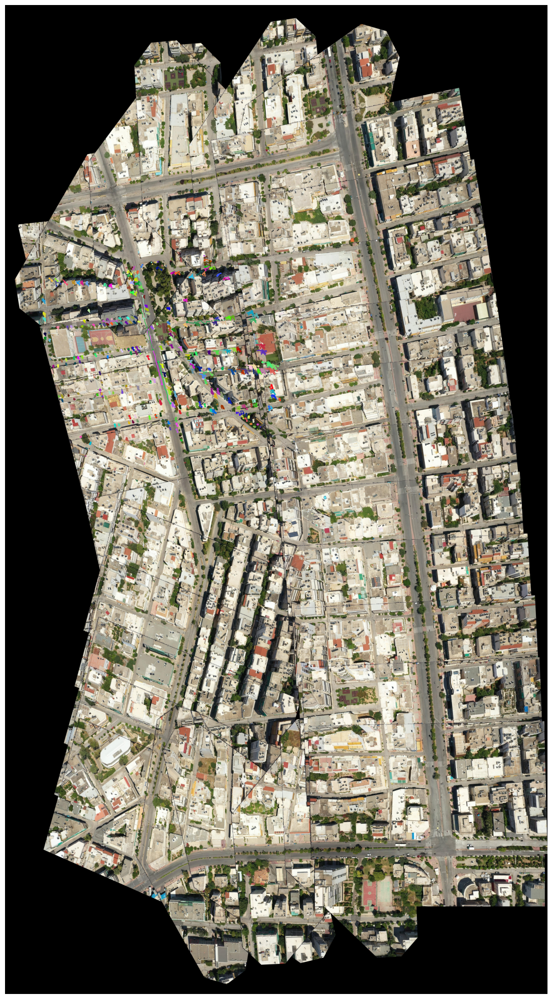

In [3]:
import matplotlib.pyplot as plt
import random

# Create a figure to display the panorama
plt.figure(figsize=(40, 20))
plt.imshow(cv.cvtColor(map_image, cv.COLOR_BGR2RGB))
plt.axis('off')

# Generate unique colors for each vehicle ID
vehicle_ids = list(trajectories.keys())
num_vehicles = len(vehicle_ids)
# random.seed(42)  # For reproducibility
colors = {}
for vehicle_id in vehicle_ids:
    colors[vehicle_id] = [random.randint(0, 255) for _ in range(3)]

# Plot the trajectories
for vehicle_id, points in trajectories.items():
    points = np.array(points)
    # Ensure points are within the image bounds
    height, width, _ = map_image.shape
    valid_indices = (points[:, 0] >= 0) & (points[:, 0] < width) & (points[:, 1] >= 0) & (points[:, 1] < height)
    points = points[valid_indices]
    if points.shape[0] >= 2:
        plt.plot(points[:, 0], points[:, 1], '-', color=np.array(colors[vehicle_id])/255.0, linewidth=1, label=f'ID {vehicle_id}')
        # Optionally, mark the start and end points
        plt.plot(points[0, 0], points[0, 1], 'o', color=np.array(colors[vehicle_id])/255.0, markersize=2)
        plt.plot(points[-1, 0], points[-1, 1], 's', color=np.array(colors[vehicle_id])/255.0, markersize=2)
    elif points.shape[0] == 1:
        plt.plot(points[0, 0], points[0, 1], 'o', color=np.array(colors[vehicle_id])/255.0, markersize=1, label=f'ID {vehicle_id}')


# Save and display the final image
output_image_path = os.path.join(general_folder_path, 'panorama_with_trajectories.jpg')
plt.tight_layout()
plt.savefig(output_image_path, bbox_inches='tight')
plt.show()

In [3]:
import os
import cv2
import matplotlib.pyplot as plt
from collections import defaultdict

# Define your paths and configurations
video_path = '/home/oussama/Documents/EPFL/PDS_LUTS/Dataset/DJI_0763.MOV'
temp_folder = '/home/oussama/Documents/EPFL/PDS_LUTS/temp_frames'
txt_folder = '/home/oussama/Documents/EPFL/PDS_LUTS/Dataset/DJI_0763_detection'
output_folder = '/home/oussama/Documents/EPFL/PDS_LUTS/inpainted_frames'

map_image_path = '/home/oussama/Documents/EPFL/PDS_LUTS/final_panorama.jpg'
map_image = cv.imread(map_image_path)

images_folder = '/home/oussama/Documents/EPFL/PDS_LUTS/images_updated'
tracking_folder = '/home/oussama/Documents/EPFL/PDS_LUTS/Dataset/DJI_0763_tracking'

corners_csv_path = '/home/oussama/Documents/EPFL/PDS_LUTS/results/image_corners.csv'
image_corners_df = pd.read_csv(corners_csv_path)

step_frame = 10  # Process every 10th frame

# List all items in the folder to determine frame ranges
frame_files = sorted([f for f in os.listdir(images_folder) if f.endswith('.jpg')])
frame_numbers = [int(os.path.splitext(f)[0]) for f in frame_files]  # Extract frame numbers

# Initialize list to store all trajectories dictionaries
all_trajectories = []

for i in range(0, len(frame_numbers)):
    # Define start and end frames for the current batch
    start_frame = frame_numbers[i]
    if i + 1 >= len(frame_numbers):
        break

    if (frame_numbers[i] > 2000 and frame_numbers[i] < 2800) or (frame_numbers[i] > 5500 and frame_numbers[i] < 6000):
        continue
    end_frame = frame_numbers[i + 1]

    print(f"Processing frames from {start_frame} to {end_frame}...")

    # Call the select_and_inpaint_frames function
    select_and_inpaint_frames(
        video_path=video_path,
        temp_folder=temp_folder,
        txt_folder=txt_folder,
        output_folder=output_folder,
        start_frame=start_frame,
        step_frame=step_frame,
        end_frame=end_frame
    )

    # Initialize a new trajectories dictionary for this batch
    trajectories = defaultdict(list)

    # Call the track_vehicles_in_between_frames function
    trajectories = track_vehicles_in_between_frames(
        map_image=map_image,
        df=image_corners_df,
        images_folder=output_folder,
        bounding_data_folder=tracking_folder,
        start_frame=start_frame,
        end_frame=end_frame,
        step_frame=step_frame,
        trajectories=trajectories,  # Pass the new dictionary
        confidence_threshold=0.5
    )

    # Add this batch's trajectories to the list
    all_trajectories.append(trajectories)

Processing frames from 0 to 223...


Processing frames: 100%|██████████| 23/23 [00:03<00:00,  6.76it/s]


Using offset_x=5062.92516327, offset_y=11968.16992188 for global coordinates.
Processing frames from 223 to 413...


Processing frames: 100%|██████████| 19/19 [00:04<00:00,  4.11it/s]


Using offset_x=4954.7481842, offset_y=10898.49035645 for global coordinates.
Processing frames from 413 to 601...


Processing frames: 100%|██████████| 19/19 [00:06<00:00,  2.82it/s]


Using offset_x=4831.82050323, offset_y=9866.57397461 for global coordinates.
Processing frames from 601 to 791...


Processing frames: 100%|██████████| 19/19 [00:08<00:00,  2.25it/s]


Using offset_x=4724.85723114, offset_y=8831.14453125 for global coordinates.
Processing frames from 791 to 981...


Processing frames: 100%|██████████| 19/19 [00:09<00:00,  1.92it/s]


Using offset_x=4604.12065125, offset_y=7799.046875 for global coordinates.
Processing frames from 981 to 1168...


Processing frames: 100%|██████████| 18/18 [00:12<00:00,  1.48it/s]


Using offset_x=4456.40162659, offset_y=6836.36053467 for global coordinates.
Processing frames from 1168 to 1358...


Processing frames: 100%|██████████| 19/19 [00:13<00:00,  1.39it/s]


Using offset_x=4313.01094055, offset_y=5784.66394043 for global coordinates.
Processing frames from 1358 to 1548...


Processing frames: 100%|██████████| 19/19 [00:15<00:00,  1.23it/s]


Using offset_x=4108.58055115, offset_y=4730.00769043 for global coordinates.
Processing frames from 1548 to 1736...


Processing frames: 100%|██████████| 19/19 [00:17<00:00,  1.09it/s]


Using offset_x=3883.92863464, offset_y=3654.4465332 for global coordinates.
Processing frames from 1736 to 1923...


Processing frames: 100%|██████████| 19/19 [00:19<00:00,  1.02s/it]


Using offset_x=3653.6525116, offset_y=2574.23840332 for global coordinates.
Processing frames from 1923 to 2113...


Processing frames: 100%|██████████| 19/19 [00:20<00:00,  1.08s/it]


Using offset_x=3441.48828125, offset_y=1383.05944824 for global coordinates.
Processing frames from 2818 to 3008...


Processing frames: 100%|██████████| 19/19 [00:29<00:00,  1.54s/it]


Using offset_x=363.45483398, offset_y=362.0980835 for global coordinates.
Processing frames from 3008 to 3373...


Processing frames: 100%|██████████| 37/37 [00:33<00:00,  1.11it/s]


Using offset_x=-0.66418457, offset_y=401.1997261 for global coordinates.
Processing frames from 3373 to 3553...


Processing frames: 100%|██████████| 18/18 [00:33<00:00,  1.89s/it]


Using offset_x=-0.66418457, offset_y=1016.69177 for global coordinates.
Processing frames from 3553 to 3743...


Processing frames: 100%|██████████| 19/19 [00:36<00:00,  1.91s/it]


Using offset_x=213.29759216, offset_y=3284.65924072 for global coordinates.
Processing frames from 3743 to 3931...


Processing frames: 100%|██████████| 19/19 [00:37<00:00,  1.99s/it]


Using offset_x=386.55264282, offset_y=3990.65350342 for global coordinates.
Processing frames from 3931 to 4118...


Processing frames: 100%|██████████| 18/18 [00:39<00:00,  2.20s/it]


Using offset_x=578.79129028, offset_y=4767.92602539 for global coordinates.
Processing frames from 4118 to 4308...


Processing frames: 100%|██████████| 19/19 [00:41<00:00,  2.18s/it]


Using offset_x=835.3274231, offset_y=5612.16741943 for global coordinates.
Processing frames from 4308 to 4498...


Processing frames: 100%|██████████| 19/19 [00:42<00:00,  2.23s/it]


Using offset_x=1111.88545227, offset_y=6606.47503662 for global coordinates.
Processing frames from 4498 to 4761...


Processing frames: 100%|██████████| 27/27 [00:45<00:00,  1.70s/it]


Using offset_x=1311.54354858, offset_y=7498.54516602 for global coordinates.
Processing frames from 4761 to 4951...


Processing frames: 100%|██████████| 19/19 [00:47<00:00,  2.48s/it]


Using offset_x=1159.73936462, offset_y=8299.55065918 for global coordinates.
Processing frames from 4951 to 5141...


Processing frames: 100%|██████████| 19/19 [00:48<00:00,  2.55s/it]


Using offset_x=981.0486908, offset_y=9239.18731689 for global coordinates.
Processing frames from 5141 to 5331...


Processing frames: 100%|██████████| 19/19 [00:51<00:00,  2.69s/it]


Using offset_x=820.47654724, offset_y=10230.73394775 for global coordinates.
Processing frames from 5331 to 5521...


Processing frames: 100%|██████████| 19/19 [00:52<00:00,  2.79s/it]


Using offset_x=642.89569092, offset_y=11048.91564941 for global coordinates.
Processing frames from 6073 to 6263...


Processing frames: 100%|██████████| 19/19 [00:59<00:00,  3.11s/it]


Using offset_x=1397.83514404, offset_y=11550.18930054 for global coordinates.
Processing frames from 6263 to 6453...


Processing frames: 100%|██████████| 19/19 [01:01<00:00,  3.26s/it]


Using offset_x=1900.90386963, offset_y=11676.49857712 for global coordinates.
Processing frames from 6453 to 6643...


Processing frames: 100%|██████████| 19/19 [01:02<00:00,  3.30s/it]


Using offset_x=2836.52069092, offset_y=11676.49857712 for global coordinates.
Processing frames from 6643 to 6833...


Processing frames: 100%|██████████| 19/19 [01:04<00:00,  3.38s/it]

Frame data not found for frames 6643 or 6833.


NameError: name 'all_trajectories' is not defined

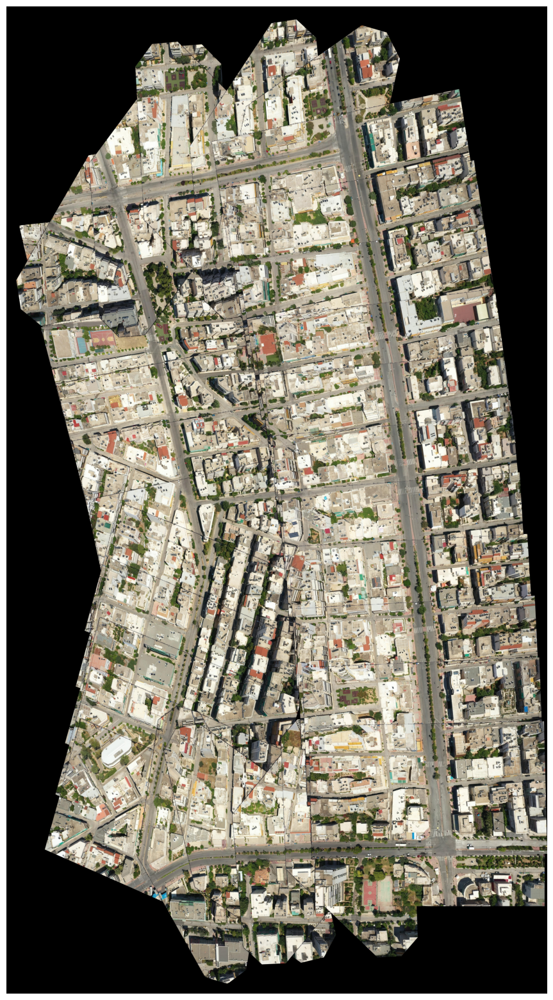

In [4]:
import matplotlib.pyplot as plt
import random

# Create a figure to display the panorama
plt.figure(figsize=(40, 20))
plt.imshow(cv.cvtColor(map_image, cv.COLOR_BGR2RGB))
plt.axis('off')

# Initialize the colors dictionary
colors = {}

for trajectories in all_trajectories:
    for vehicle_id, points in trajectories.items():
        # Assign a random color if this vehicle_id is not already in colors
        if vehicle_id not in colors:
            colors[vehicle_id] = [random.randint(0, 255) for _ in range(3)]

        points = np.array(points)
        # Ensure points are within the image bounds
        height, width, _ = map_image.shape
        valid_indices = (points[:, 0] >= 0) & (points[:, 0] < width) & (points[:, 1] >= 0) & (points[:, 1] < height)
        points = points[valid_indices]

        if points.shape[0] >= 2:
            plt.plot(points[:, 0], points[:, 1], '-', color=np.array(colors[vehicle_id])/255.0, linewidth=1, label=f'ID {vehicle_id}')
            # Optionally, mark the start and end points
            plt.plot(points[0, 0], points[0, 1], 'o', color=np.array(colors[vehicle_id])/255.0, markersize=2)
            plt.plot(points[-1, 0], points[-1, 1], 's', color=np.array(colors[vehicle_id])/255.0, markersize=2)
        elif points.shape[0] == 1:
            plt.plot(points[0, 0], points[0, 1], 'o', color=np.array(colors[vehicle_id])/255.0, markersize=1, label=f'ID {vehicle_id}')

# Save and display the final image
output_image_path = os.path.join(general_folder_path, 'panorama_with_trajectories.jpg')
plt.tight_layout()
plt.savefig(output_image_path, bbox_inches='tight')
plt.show()


In [5]:
import pickle 

with open('saved_dictionary.pkl', 'wb') as f:
    pickle.dump(all_trajectories, f)

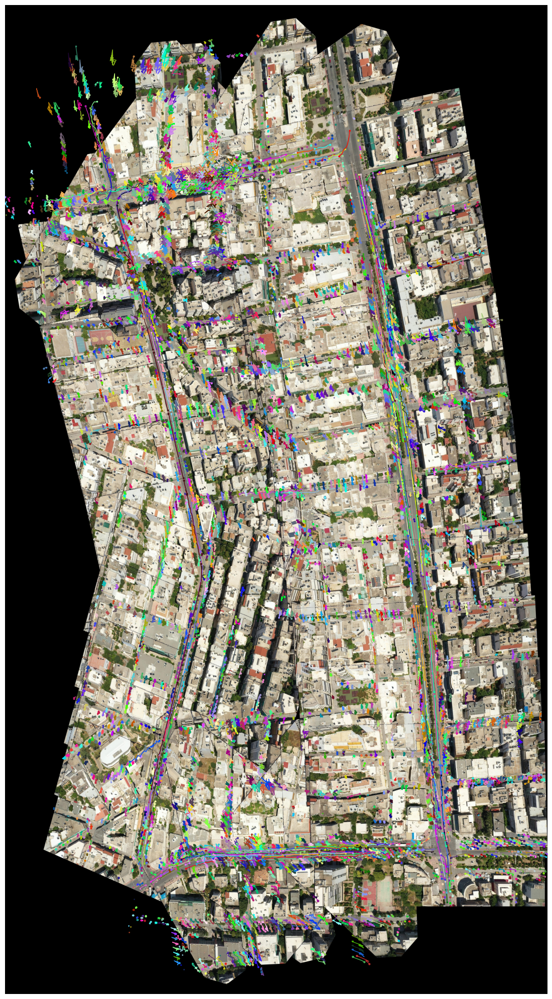

In [2]:
import pickle

with open('saved_dictionary.pkl', 'rb') as f:
    loaded_dict = pickle.load(f)

import matplotlib.pyplot as plt
import random
import cv2 as cv
import numpy as np
import os

map_image_path = 'final_panorama.jpg'
map_image = cv.imread(map_image_path)

# Create a figure to display the panorama
plt.figure(figsize=(40, 20))
plt.imshow(cv.cvtColor(map_image, cv.COLOR_BGR2RGB))
plt.axis('off')

# Initialize the colors dictionary
colors = {}

# trajectories = loaded_dict[14]
for trajectories in loaded_dict:
    if trajectories == loaded_dict[14]:
        continue
    for vehicle_id, points in trajectories.items():
        # Assign a random color if this vehicle_id is not already in colors
        if vehicle_id not in colors:
            colors[vehicle_id] = [random.randint(0, 255) for _ in range(3)]

        points = np.array(points)
        # Ensure points are within the image bounds
        height, width, _ = map_image.shape
        valid_indices = (points[:, 0] >= 0) & (points[:, 0] < width) & (points[:, 1] >= 0) & (points[:, 1] < height)
        points = points[valid_indices]

        if points.shape[0] >= 2:
            plt.plot(points[:, 0], points[:, 1], '-', color=np.array(colors[vehicle_id])/255.0, linewidth=1, label=f'ID {vehicle_id}')
            # Optionally, mark the start and end points
            plt.plot(points[0, 0], points[0, 1], 'o', color=np.array(colors[vehicle_id])/255.0, markersize=2)
            plt.plot(points[-1, 0], points[-1, 1], 's', color=np.array(colors[vehicle_id])/255.0, markersize=2)
        elif points.shape[0] == 1:
            plt.plot(points[0, 0], points[0, 1], 'o', color=np.array(colors[vehicle_id])/255.0, markersize=1, label=f'ID {vehicle_id}')

# Save and display the final image
output_image_path = 'panorama_with_trajectories.jpg'
plt.tight_layout()
plt.savefig(output_image_path, bbox_inches='tight')
plt.show()



In [42]:
import math
import numpy as np

def compute_turn_angles(points):
    """
    Return list of turn angles between consecutive segments in degrees.
    """
    angles = []
    for i in range(len(points) - 2):
        v1 = points[i+1] - points[i]
        v2 = points[i+2] - points[i+1]
        mag_v1 = np.linalg.norm(v1)
        mag_v2 = np.linalg.norm(v2)
        if mag_v1 == 0 or mag_v2 == 0:
            continue  # skip degenerate segments
        dot_product = np.dot(v1, v2)
        cos_angle = dot_product / (mag_v1 * mag_v2)
        cos_angle = np.clip(cos_angle, -1.0, 1.0)  # numerical stability
        angle_rad = math.acos(cos_angle)
        angle_deg = math.degrees(angle_rad)
        angles.append(angle_deg)
    return angles

def compute_bounding_radius(points):
    """
    Compute a simple bounding radius for a set of points:
    - centroid = average (x, y)
    - bounding radius = max distance of any point to centroid
    """
    if len(points) == 0:
        return 0.0
    centroid = np.mean(points, axis=0)  # shape (2,)
    distances = np.linalg.norm(points - centroid, axis=1)
    return np.max(distances)

def classify_trajectory(points, angle_threshold=90, fraction_allowed=0.3, radius_threshold=50):
    """
    Classify a trajectory into one of three categories:
      - 'big_anomaly'
      - 'small_anomaly'
      - 'normal'

    Criteria:
      1) Compute fraction_exceed = fraction of turn angles > angle_threshold.
      2) Compute bounding radius.
      3) If fraction_exceed > fraction_allowed:
           - If bounding_radius > radius_threshold => 'big_anomaly'
           - Else => 'small_anomaly'
         else => 'normal'
    """
    angles = compute_turn_angles(points)
    # If very few points => no angles => consider it normal or handle as you wish
    if len(angles) < 2:
        return 1

    # fraction of angles that exceed threshold
    count_exceed = sum(1 for a in angles if a > angle_threshold)
    fraction_exceed = count_exceed / len(angles)

    # compute bounding radius
    bounding_radius = compute_bounding_radius(points)

    # check anomaly logic
    if fraction_exceed > fraction_allowed:
        # It's an anomaly. Distinguish big vs. small based on radius
        if bounding_radius > radius_threshold:
            return 2
        else:
            return 1
    else:
        return 0


number of vehicls shown is: 8159


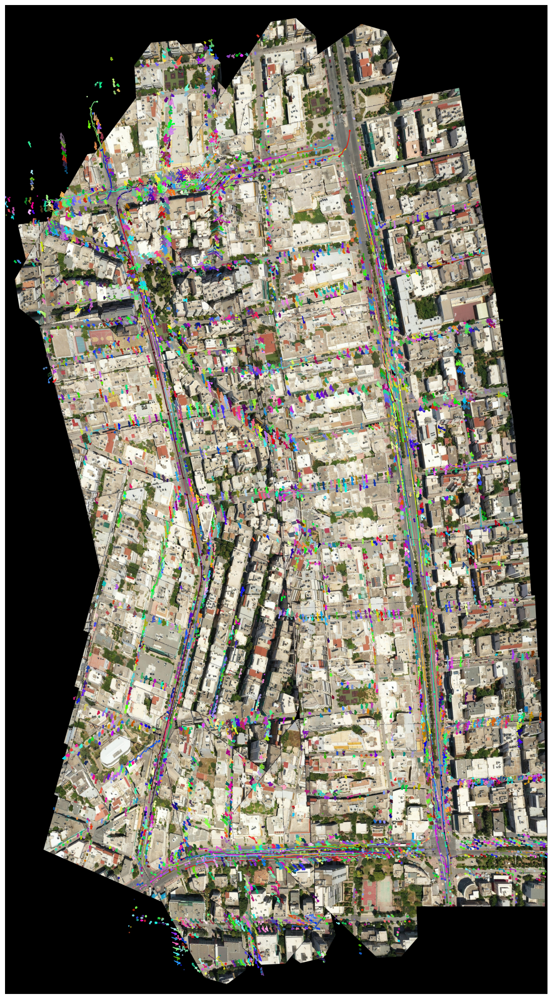

In [61]:
# Create a figure to display the panorama
plt.figure(figsize=(40, 20))
plt.imshow(cv.cvtColor(map_image, cv.COLOR_BGR2RGB))
plt.axis('off')
i=0
for trajectories in loaded_dict:
    # e.g., skip loaded_dict[14] if that's your logic
    if trajectories == loaded_dict[14]:
        continue

    for vehicle_id, points in trajectories.items():
        # Convert points to NumPy and do your bounding checks
        points = np.array(points)
        height, width, _ = map_image.shape
        valid_indices = (
            (points[:, 0] >= 0) & (points[:, 0] < width) &
            (points[:, 1] >= 0) & (points[:, 1] < height)
        )
        points = points[valid_indices]

        # Classify the trajectory
        label = classify_trajectory(points,
                                    angle_threshold=60,
                                    fraction_allowed=0.4,
                                    radius_threshold=100)

        # Decide whether to plot
        if label == 2 or label == 2:
            # Skip it (don't plot)
            continue

        i+=1
        
        # if label == 1:
        #     if points.shape[0] > 0:
        #         centroid = np.mean(points, axis=0)
        #         plt.plot(centroid[0], centroid[1], 'o',  # diamond marker
        #                  color=np.array(colors[vehicle_id])/255.0,
        #                  markersize=2, label=f'Stopped ID {vehicle_id}')
        #     continue  # skip the rest of the logic below

        # Otherwise, it's normal => plot
        if points.shape[0] >= 2:
            plt.plot(points[:, 0], points[:, 1], '-',
                     color=np.array(colors[vehicle_id])/255.0,
                     linewidth=1, label=f'ID {vehicle_id}')
            # Start & end markers
            plt.plot(points[0, 0], points[0, 1], 'o',
                     color=np.array(colors[vehicle_id])/255.0,
                     markersize=2)
            plt.plot(points[-1, 0], points[-1, 1], 's',
                     color=np.array(colors[vehicle_id])/255.0,
                     markersize=2)
        elif points.shape[0] == 1:
            plt.plot(points[0, 0], points[0, 1], 'o',
                     color=np.array(colors[vehicle_id])/255.0,
                     markersize=1, label=f'ID {vehicle_id}')

print(f"number of vehicls shown is: {i}")
plt.tight_layout()
plt.show()